# Analyzing Spotify's Top Tracks
*Jimmy Sisenglath, Eric Pham, Justin Eugenio*

Songs are mostly western, commercial tracks ranging from 1922 to 2011, with a peak in the year 2000s. Also, tagged with artist information, along with audio measurements, and other relevant information.

---

# Load libraries

In [1]:
# Data handling & stats.
import pandas as pd
import numpy as np
from scipy import interp

# Visualization.
import matplotlib.pyplot as plt
from wordcloud import WordCloud, STOPWORDS
from scipy.cluster.hierarchy import dendrogram, linkage      

# Sklearn.
from sklearn.preprocessing import OneHotEncoder     # One-hot encoding.
from sklearn import tree                            # Decision tree.
from sklearn.linear_model import LogisticRegression # Logistic regression.
from sklearn.model_selection import cross_val_score
from sklearn.svm import SVC                         # Support vector machine. 
from sklearn import metrics
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split, GridSearchCV
import sklearn.feature_extraction.text as sk_text
import sklearn.cluster as sk_cluster
from sklearn.neural_network import MLPClassifier # Neural networks.
import sklearn.metrics as metrics
import sklearn.feature_extraction.text as sk_text
from sklearn.feature_selection import RFE # Frequent Dataset Mining
from sklearn import datasets
import sklearn.linear_model as linear_model
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import StandardScaler
from warnings import simplefilter                     # Import warnings filter.
simplefilter(action='ignore', category=FutureWarning) # Ignore all future warnings.


from sklearn.model_selection import cross_val_score # Cross validation.
from sklearn.model_selection import train_test_split, GridSearchCV # Grid search.
import scipy
from sklearn import preprocessing

%matplotlib inline
pd.set_option('display.max_colwidth', -1) # Will help to show all the text strings in the column without truncation.
pd.set_option('display.max_columns', None)


# File preparation

*Classification / Regression Focused*

Real dataset contains 1 million songs (250GB~). We used the subset. Easier to work with.

---

Dataset: https://think.cs.vt.edu/corgis/csv/music/music.html (10k song subset CSV converted)

In [2]:
df_msd = pd.read_csv('MSD_data.csv') # Pandas dataframe.

# Rename all columns named 'hotttnesss' to 'hotness' instead.
df_msd.columns = df_msd.columns.str.replace('hotttnesss', 'hotness')
# Rename 'terms' to genre'
df_msd.columns = df_msd.columns.str.replace('terms', 'genre')
df_msd.columns = df_msd.columns.str.replace('.', '_')

df_msd

# Some columns are 'NaN' empty.

,artist_hotness,artist_id,artist_name,artist_mbtags,artist_mbtags_count,bars_confidence,bars_start,beats_confidence,beats_start,duration,end_of_fade_in,familiarity,key,key_confidence,latitude,location,longitude,loudness,mode,mode_confidence,release_id,release_name,similar,song_hotness,song_id,start_of_fade_out,tatums_confidence,tatums_start,tempo,genre,genre_freq,time_signature,time_signature_confidence,title,year
0,0.401998,ARD7TVE1187B99BFB1,Casual,NaN,0.0,0.643,0.58521,0.834,0.58521,218.93179,0.247,0.581794,1.0,0.736,37.157357,California - LA,-63.933358,-11.197,0,0.636,300848,Fear Itself,ARV4KO21187FB38008,0.602120,SOMZWCG12A8C13C480,218.932,0.779,0.28519,92.198,hip hop,1.000000,4.0,0.778,I Didn't Mean To,0
1,0.417500,ARMJAGH1187FB546F3,The Box Tops,classic pop and rock,1.0,0.007,0.71054,1.000,0.20627,148.03546,0.148,0.630630,6.0,0.169,35.149680,"Memphis, TN",-90.048920,-9.843,0,0.430,300822,Dimensions,ARSZWK21187B9B26D7,NaN,SOCIWDW12A8C13D406,137.915,0.969,0.20627,121.274,blue-eyed soul,1.000000,4.0,0.384,Soul Deep,1969
2,0.343428,ARKRRTF1187B9984DA,Sonora Santanera,NaN,0.0,0.980,0.73152,0.980,0.73152,177.47546,0.282,0.487357,8.0,0.643,37.157357,Not available,-63.933358,-9.689,1,0.565,514953,Las Numero 1 De La Sonora Santanera,ARFSJUG11C8A421AAD,NaN,SOXVLOJ12AB0189215,172.304,0.482,0.42132,100.070,salsa,1.000000,1.0,0.000,Amor De Cabaret,0
3,0.454231,AR7G5I41187FB4CE6C,Adam Ant,uk,1.0,0.017,1.30621,0.809,0.81002,233.40363,0.000,0.630382,0.0,0.751,37.157357,"London, England",-63.933358,-9.013,1,0.749,287650,Friend Or Foe,AR4R0741187FB39AF2,NaN,SONHOTT12A8C13493C,217.124,0.601,0.56254,119.293,pop rock,0.988584,4.0,0.000,Something Girls,1982
4,0.401724,ARXR32B1187FB57099,Gob,NaN,0.0,0.175,1.06368,0.883,0.13576,209.60608,0.066,0.651046,2.0,0.092,37.157357,Not available,-63.933358,-4.501,1,0.371,611336,Muertos Vivos,ARUA62A1187B99D9B0,0.604501,SOFSOCN12A8C143F5D,198.699,1.000,0.13576,129.738,pop punk,0.887288,4.0,0.562,Face the Ashes,2007
5,0.385471,ARKFYS91187B98E58F,Jeff And Sheri Easter,NaN,0.0,0.121,1.17118,0.438,0.74856,267.70240,2.264,0.535293,5.0,0.635,37.157357,Not available,-63.933358,-9.323,1,0.557,41838,Ordinary Day,ARHNMEZ11F50C4706C,NaN,SOYMRWW12A6D4FAB14,254.270,0.136,0.53929,147.782,southern gospel,1.000000,3.0,0.454,The Moon And I (Ordinary Day Album Version),0
6,0.261941,ARD0S291187B9B7BF5,Rated R,NaN,0.0,0.709,0.27253,0.709,0.27253,114.78159,0.096,0.556496,1.0,0.000,37.157357,Ohio,-63.933358,-17.302,1,0.000,25824,Da Ghetto Psychic,ARF93II1187B99F981,NaN,SOMJBYD12A6D4F8557,114.782,0.467,0.05611,111.787,breakbeat,1.000000,1.0,0.000,Keepin It Real (Skit),0
7,0.605507,AR10USD1187B99F3F1,Tweeterfriendly Music,NaN,0.0,0.142,0.65428,0.234,0.65428,189.57016,0.319,0.801136,4.0,0.000,37.157357,"Burlington, Ontario, Canada",-63.933358,-11.642,0,0.160,8876,Gin & Phonic,ARJXL4Z1187B9A5920,NaN,SOHKNRJ12A6701D1F8,181.023,0.292,0.36129,101.430,post-hardcore,0.999818,3.0,0.408,Drop of Rain,0
8,0.332276,AR8ZCNI1187B9A069B,Planet P Project,NaN,0.0,0.806,1.91886,0.440,1.22595,269.81832,5.300,0.426668,4.0,0.717,37.157357,Not available,-63.933358,-13.496,1,0.652,358182,Pink World,ARWVP631187FB4D016,0.265861,SOIAZJW12AB01853F1,258.990,0.121,1.22595,86.643,new wave,0.959766,4.0,0.487,Pink World,1984
9,0.422706,ARNTLGG11E2835DDB9,Clp,NaN,0.0,0.047,0.62445,1.000,0.09933,266.39628,0.084,0.550514,7.0,0.053,37.157357,Not available,-63.933358,-6.697,0,0.473,692313,Superinstrumental,ARAR1XA11C8A415BE5,NaN,SOUDSGM12AC9618304,261.747,1.000,0.09933,114.041,breakcore,0.915602,4.0,0.878,Insatiable (Instrumental Version),0


# Exploring the dataset

In [3]:
#prints out the total number of rows and columns inside our dataframe
print("There are %d rows and %d columns in the dataset." 
      %(df_msd.shape[0], df_msd.shape[1]))

There are 10000 rows and 35 columns in the dataset.


In [4]:
df_msd.columns

Index(['artist_hotness', 'artist_id', 'artist_name', 'artist_mbtags',
       'artist_mbtags_count', 'bars_confidence', 'bars_start',
       'beats_confidence', 'beats_start', 'duration', 'end_of_fade_in',
       'familiarity', 'key', 'key_confidence', 'latitude', 'location',
       'longitude', 'loudness', 'mode', 'mode_confidence', 'release_id',
       'release_name', 'similar', 'song_hotness', 'song_id',
       'start_of_fade_out', 'tatums_confidence', 'tatums_start', 'tempo',
       'genre', 'genre_freq', 'time_signature', 'time_signature_confidence',
       'title', 'year'],
      dtype='object')

# Displays the columns and types of values in our dataframe

In [5]:
# Displays the columns and types of values in our dataframe.
df_msd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 35 columns):
artist_hotness               10000 non-null float64
artist_id                    10000 non-null object
artist_name                  10000 non-null object
artist_mbtags                3711 non-null object
artist_mbtags_count          10000 non-null float64
bars_confidence              10000 non-null float64
bars_start                   10000 non-null float64
beats_confidence             10000 non-null float64
beats_start                  10000 non-null float64
duration                     10000 non-null float64
end_of_fade_in               10000 non-null float64
familiarity                  9996 non-null float64
key                          10000 non-null float64
key_confidence               10000 non-null float64
latitude                     10000 non-null float64
location                     10000 non-null object
longitude                    10000 non-null float64
loudness      

# Music genres in the dataset

In [6]:
# Music genres.
df_msd['genre']

0       hip hop           
1       blue-eyed soul    
2       salsa             
3       pop rock          
4       pop punk          
5       southern gospel   
6       breakbeat         
7       post-hardcore     
8       new wave          
9       breakcore         
10      alternative rock  
11      ccm               
12      bachata           
13      chanson           
14      quiet storm       
15      country rock      
16      chill-out         
17      qawwali           
18      hard rock         
19      indietronica      
20      classic country   
21      electric blues    
22      uk garage         
23      math-core         
24      pop rock          
25      post-grunge       
26      breakcore         
27      filk              
28      latin jazz        
29      jump blues        
           ...            
9970    indie rock        
9971    progressive house 
9972    blues             
9973    punk              
9974    dance pop         
9975    latin jazz        
9

# List range of years

In [7]:
# Duration seems to go up as years progress.
duration = df_msd.groupby(by = 'year').mean()
duration.drop(labels=0, inplace=True)
duration

,artist_hotness,artist_mbtags_count,bars_confidence,bars_start,beats_confidence,beats_start,duration,end_of_fade_in,familiarity,key,key_confidence,latitude,longitude,loudness,mode,mode_confidence,release_id,song_hotness,start_of_fade_out,tatums_confidence,tatums_start,tempo,genre_freq,time_signature,time_signature_confidence
year,,,,,,,,,,,,,,,,,,,,,,,,,
1926,0.382847,1.000000,0.059500,0.756590,0.875500,0.467195,176.770160,0.572000,0.594867,2.500000,0.116500,31.168900,-100.077150,-21.672500,1.000000,0.270000,183909.000000,NaN,169.929500,0.193000,0.467195,101.002500,0.950350,3.500000,0.340000
1927,0.384586,0.666667,0.379333,0.606620,0.523000,0.194510,188.699410,0.190000,0.564467,5.666667,0.421000,32.366597,-89.189237,-16.135000,0.666667,0.379000,388163.666667,NaN,185.116000,0.474333,0.194510,131.065333,0.983253,2.666667,0.204667
1929,0.375594,1.000000,0.107000,2.732800,0.000000,0.139670,191.111380,0.729000,0.574300,6.000000,0.001000,32.331120,-90.605360,-14.873000,1.000000,0.129000,190889.000000,NaN,184.506000,0.111000,0.139670,114.177000,0.996954,7.000000,0.535000
1930,0.364315,0.500000,0.497000,0.363205,0.497000,0.363205,196.753830,0.226500,0.546650,5.000000,0.556000,34.038535,-90.068560,-16.751000,1.000000,0.577000,432899.500000,NaN,190.218000,0.079000,0.230730,133.322000,0.982283,1.000000,0.000000
1934,0.375594,1.000000,0.052000,0.188970,0.923000,0.188970,173.322000,0.525000,0.574300,5.000000,0.376000,32.331120,-90.605360,-30.530000,0.000000,0.405000,546652.000000,NaN,165.785000,0.074000,0.188970,100.795000,0.996954,3.000000,0.996000
1935,0.353036,0.000000,0.623500,0.258250,0.623500,0.258250,176.090975,0.080000,0.519000,11.000000,0.523500,35.745950,-89.531760,-17.083500,1.000000,0.546500,388129.500000,NaN,172.190500,0.013000,0.258250,87.740000,0.967612,1.000000,0.263500
1936,0.342627,0.000000,0.838000,2.177900,0.666000,0.565920,192.809340,0.491000,0.481704,4.000000,0.195000,37.157357,-63.933358,-10.697000,0.000000,0.274000,651071.000000,NaN,189.980000,0.566000,0.185420,38.443000,1.000000,4.000000,0.000000
1940,0.424488,0.000000,0.479000,0.762480,0.468000,0.457925,165.655055,0.732000,0.572471,6.000000,0.636500,33.896270,-89.000180,-18.690000,1.000000,0.555000,357927.500000,NaN,160.958000,0.541500,0.308110,101.541500,0.979291,2.500000,0.474500
1947,0.313648,0.000000,0.036500,1.826450,0.211500,0.467625,177.906485,0.515000,0.425883,9.000000,0.587500,39.144650,-89.108270,-19.494500,1.000000,0.496500,358355.500000,NaN,174.901500,0.521000,0.146065,113.624500,1.000000,4.500000,0.711500


# Visualize how many songs were released from 1926 to 2010

Text(0.5, 1.0, 'Song Release Dates')

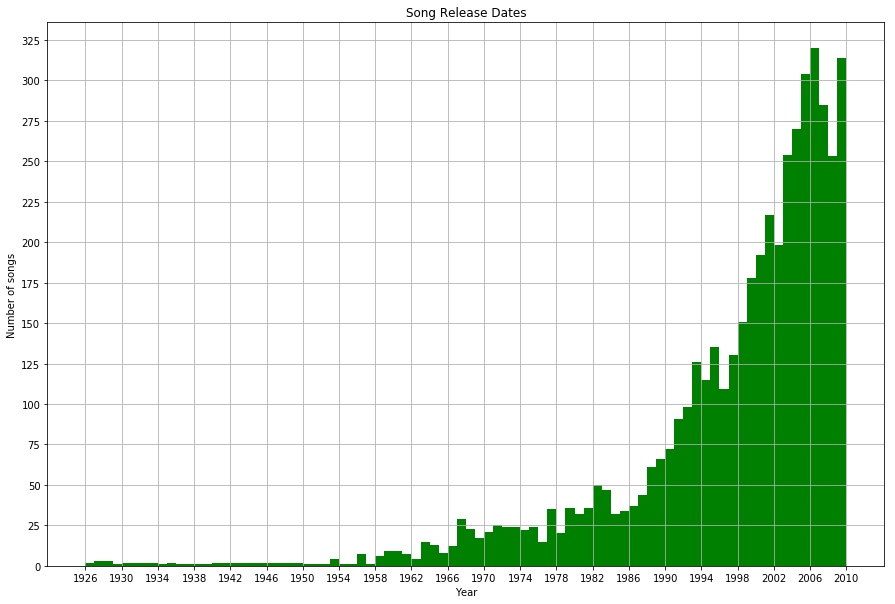

In [8]:
plt.figure(figsize=(15,10))
plt.hist(df_msd['year'], bins=duration.index, color = 'green');
plt.ylabel('Number of songs'); plt.xlabel('Year')
plt.xticks(np.arange(1926,2014,4)); plt.yticks(np.arange(0,350,25))
plt.grid(b = True, which = 'both', axis = 'both')

# Histogram. Showing the trend of release dates.
plt.title('Song Release Dates')

# Finding out the top genres before cleaning the data

In [9]:
# Finding out top genres before cleaning.

top_genres = pd.DataFrame(df_msd.groupby(by='genre').count())
top_genres = pd.DataFrame(top_genres['song_id'])
top_genres.reset_index(inplace=True)
top_genres.columns = ['genre','count']
top_genres.sort_values(by='count', axis=0, ascending=False, inplace=True)

top_genres

,genre,count
36,blues-rock,346
215,hip hop,346
60,ccm,255
69,chanson,208
102,country rock,156
253,latin jazz,150
328,post-grunge,146
106,dance pop,141
179,gangster rap,134
366,roots reggae,131


# Start data cleaning & find most important features

Look at sklearn lab 3 for feature selection analysis. Find the best features and train your models on it. Remove useless features. (2. feature selection and RFE).

In [10]:
df_msd_clean = df_msd.dropna(how='any', inplace=False)
df_msd_clean = df_msd_clean.reset_index(drop=True)

#Created dataframe that with attributes that has all the strings to be vectorized
df_msd_vect =  df_msd_clean[['artist_id', 'artist_mbtags', 'artist_name', 'location', 'release_name', 'similar', 'song_id','genre', 'song_hotness']]

#Created dataframe with all the attributes that has numeric values to be normalized
df_msd_num = df_msd_clean[['artist_hotness', 'artist_mbtags_count','bars_confidence', 'bars_start', 'beats_confidence', 
       'beats_start','familiarity', 'key', 'key_confidence', 'loudness', 'mode', 'mode_confidence', 'song_hotness',
        'start_of_fade_out', 'tatums_confidence', 'tatums_start', 'tempo', 'genre_freq', 'time_signature', 
        'time_signature_confidence', 'year']]
df_msd_clean

,artist_hotness,artist_id,artist_name,artist_mbtags,artist_mbtags_count,bars_confidence,bars_start,beats_confidence,beats_start,duration,end_of_fade_in,familiarity,key,key_confidence,latitude,location,longitude,loudness,mode,mode_confidence,release_id,release_name,similar,song_hotness,song_id,start_of_fade_out,tatums_confidence,tatums_start,tempo,genre,genre_freq,time_signature,time_signature_confidence,title,year
0,0.447935,ARD842G1187B997376,Blue Rodeo,canadian,2.0,0.507,1.32118,0.000,0.30065,491.12771,0.000,0.636424,7.0,1.000,43.648560,"Toronto, Ontario, Canada",-79.385330,-8.576,1,0.829,135122,Outskirts,ARGCEMX1187B9921A4,0.405116,SOHUOAP12A8AE488E9,486.034,0.377,0.05047,119.826,country rock,1.000000,4.0,0.756,Floating,1987
1,0.541889,ARMAC4T1187FB3FA4C,The Dillinger Escape Plan,rock and indie,1.0,0.027,1.06698,0.931,0.33578,207.77751,0.061,0.839963,7.0,0.381,40.826240,"Morris Plains, NJ",-74.479950,-4.264,1,0.453,223365,Miss Machine,ARNUJQM1187FB3EE72,0.666528,SOBBUGU12A8C13E95D,204.696,0.654,0.15349,166.862,math-core,0.944381,4.0,0.000,Setting Fire to Sleeping Giants,2004
2,0.416173,ARB29H41187B98F0EF,Terry Callier,classic pop and rock,1.0,0.145,0.96908,0.708,0.42073,342.56934,0.063,0.706828,6.0,0.381,41.884150,Chicago,-87.632410,-11.939,1,0.538,228326,Occasional Rain,ARTB5PP1187FB523B7,0.413740,SOGNCJP12A58A80271,333.154,0.462,0.13836,110.189,soul jazz,0.985011,3.0,0.353,Do You Finally Need A Friend,1972
3,0.488020,ARPQ4Z01187FB3A736,Butthole Surfers,texas,1.0,0.035,0.24380,0.604,0.24380,450.84689,0.467,0.809324,4.0,0.726,29.424490,"San Antonio, TX",-98.494620,-9.063,0,0.367,244586,Piouhgd + Widowermaker!,ARCDZ0K1187FB43757,0.593943,SOJXVAH12A8C139700,426.104,0.267,0.09307,130.586,noise rock,1.000000,4.0,0.420,"Barking Dogs (From ""Piouhgd"")",0
4,0.294861,ARDD1RC1187B9B52B4,Jacob Young,jazz and blues,1.0,0.238,0.92047,0.908,0.23284,456.30649,0.241,0.495446,1.0,0.611,37.157357,Not available,-63.933358,-19.478,1,0.546,730551,Pieces Of Time,ARM8XWM1187FB4E225,0.000000,SOOGFBZ12AC3DF7FF2,451.315,0.000,0.06094,89.667,cool jazz,0.878319,4.0,0.747,In A Subtle Way,0
5,0.735766,ARFCUN31187B9AD578,The Rolling Stones,british,4.0,0.797,0.15016,0.797,0.15016,271.49016,0.171,0.814830,9.0,0.301,51.506320,"London, England",-0.127140,-10.358,0,0.392,42595,Jump Back - The Best Of The Rolling Stones_ '71-'93,ARSAIUN1187FB398D3,0.834493,SONQBUB12A6D4F8ED0,263.784,0.018,0.15016,139.333,blues,0.999983,1.0,0.000,Angie (1993 Digital Remaster),0
6,0.442766,ARV1JVD1187B9AD195,Loudon Wainwright III,easy listening soundtracks and musicals,1.0,0.077,1.56662,0.799,0.37554,190.48444,0.258,0.661080,3.0,0.544,35.914630,"Chapel Hill, NC",-79.056610,-15.663,1,0.596,28723,Grown Man,ARYXGMM1187B9AC285,0.510119,SOINBCU12A6D4F94C0,177.029,0.537,0.37554,102.428,modern rock,1.000000,4.0,0.496,Human Cannonball,1995
7,0.466629,AR7TTS41187B9B42D3,R.L. Burnside,delta blues,1.0,0.002,0.93659,0.885,0.27500,277.78567,0.240,0.701181,2.0,0.000,34.364010,"Oxford, MS",-89.518770,-6.944,1,0.000,557761,A Bothered Mind,AR3KUCG1187B9A0BEA,0.482138,SOTWVQT12A58A79650,267.453,0.963,0.27500,89.984,delta blues,0.980350,4.0,0.000,Glory Be,2004
8,0.394217,ARRJNTE1187FB44E12,Casiotone For The Painfully Alone,dance and electronica,1.0,0.002,0.74575,0.706,0.32409,175.72526,0.734,0.665322,0.0,0.522,37.157357,Not available,-63.933358,-10.930,1,0.474,234425,Etiquette,AREX9GE1187FB41987,0.785892,SOTUNMH12A6D4FA3E6,168.699,1.000,0.11431,141.919,trip hop,0.877629,4.0,0.445,Nashville Parthenon,2006
9,0.479308,ARS1OWB1187B99EEAD,The New York Dolls,punk,1.0,0.877,0.12284,0.877,0.12284,344.05832,0.068,0.717671,11.0,0.425,37.157357,"New York, NY",-63.933358,-9.253,1,0.486,74655,Too Much Too Soon,AR9B5JX1187FB55D84,0.561692,SOGKIWV12A6D4F86C4,335.029,0.560,0.12284,154.953,glam rock,0.998786,1.0,0.000,Human Being,1974


# Vectorizing artist_id, artist_name, artist_mbtags, location, similar, song_id, and genre features to the dataset

In [11]:
#df_msd_vect['artist_id'].fillna(value='9999', inplace = True)
#Vectorizing artist_id
vectorizer = sk_text.TfidfVectorizer(
    stop_words='english',
    max_features=2000, # 2000 takes a while...
                                     
    # .1 Means "ignore terms that appear in less than 1% of the documents".
                                     
    # The default min_df is 1, which means "ignore terms that appear in less than 1 document". 
    # Thus, the default setting does not ignore any terms.        
    min_df=1, # Creates column for every...
                             
    # If .5: ignore terms that appear in more than 50% of the documents.
    #max_df=.9, 
)

 #artist_hotness, familiarity, longitude, loudness, genre_freq 
#are the winners. CONGRATS FELLOW FEATURES!

matrix = vectorizer.fit_transform(df_msd_vect.artist_id)
print(matrix.shape)
print(type(matrix))         
tfidf_data = matrix.toarray() 
print(tfidf_data)

(2283, 896)
<class 'scipy.sparse.csr.csr_matrix'>
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


In [12]:
#df_msd_vect['artist_name'].fillna(value='9999', inplace = True)
#Vectorizing artist_name
vectorizer2 = sk_text.TfidfVectorizer(
    stop_words='english',
    max_features=2000, # 2000 takes a while...
                                     
    # .1 Means "ignore terms that appear in less than 1% of the documents".
                                     
    # The default min_df is 1, which means "ignore terms that appear in less than 1 document". 
    # Thus, the default setting does not ignore any terms.        
    min_df=1, # Creates column for every...
                             
    # If .5: ignore terms that appear in more than 50% of the documents.
    #max_df=.9, 
)

matrix2 = vectorizer2.fit_transform(df_msd_vect.artist_name)
print(matrix2.shape)
print(type(matrix2))         
tfidf_data2 = matrix2.toarray() 
print(tfidf_data2)

(2283, 1610)
<class 'scipy.sparse.csr.csr_matrix'>
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


In [13]:
#Replaces spaces with underscores so when vectorized, it does not seperate the value
df_msd_vect['artist_mbtags'].str.replace(' ', '_')
#Replaced the NaN with 9999 value
#df_msd_vect['artist_mbtags'].fillna(value='9999', inplace = True)

#Vectorizing artist_mbtags
vectorizer3 = sk_text.TfidfVectorizer(
    stop_words='english',
    max_features=2000, # 2000 takes a while...
                                     
    # .1 Means "ignore terms that appear in less than 1% of the documents".
                                     
    # The default min_df is 1, which means "ignore terms that appear in less than 1 document". 
    # Thus, the default setting does not ignore any terms.        
    min_df=1, # Creates column for every...
                             
    # If .5: ignore terms that appear in more than 50% of the documents.
    #max_df=.9, 
)

matrix3 = vectorizer3.fit_transform(df_msd_vect.artist_mbtags)
print(matrix3.shape)
print(type(matrix3))         
tfidf_data3 = matrix3.toarray() 
print(tfidf_data3)

(2283, 251)
<class 'scipy.sparse.csr.csr_matrix'>
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


In [14]:
#df_msd_vect['location'].fillna(value='9999', inplace = True)

#Vectorizing location
vectorizer4 = sk_text.TfidfVectorizer(
    stop_words='english',
    max_features=2000, # 2000 takes a while...
                                     
    # .1 Means "ignore terms that appear in less than 1% of the documents".
                                     
    # The default min_df is 1, which means "ignore terms that appear in less than 1 document". 
    # Thus, the default setting does not ignore any terms.        
    min_df=1, # Creates column for every...
                             
    # If .5: ignore terms that appear in more than 50% of the documents.
    #max_df=.9, 
)

matrix4 = vectorizer4.fit_transform(df_msd_vect.location)
print(matrix4.shape)
print(type(matrix4))         
tfidf_data4 = matrix4.toarray() 
print(tfidf_data4)

(2283, 473)
<class 'scipy.sparse.csr.csr_matrix'>
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


In [15]:
#Replaces all the NaN values to 9999 values
#df_msd_vect['similar'].fillna(value='9999', inplace = True)

#Vectorizing similar attribute
vectorizer5 = sk_text.TfidfVectorizer(
    stop_words='english',
    max_features=2000, # 2000 takes a while...
                                     
    # .1 Means "ignore terms that appear in less than 1% of the documents".
                                     
    # The default min_df is 1, which means "ignore terms that appear in less than 1 document". 
    # Thus, the default setting does not ignore any terms.        
    min_df=1, # Creates column for every...
                             
    # If .5: ignore terms that appear in more than 50% of the documents.
    #max_df=.9, 
)

matrix5 = vectorizer5.fit_transform(df_msd_vect.similar)
print(matrix5.shape)
print(type(matrix5))         
tfidf_data5 = matrix5.toarray() 
print(tfidf_data5)

(2283, 693)
<class 'scipy.sparse.csr.csr_matrix'>
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


In [16]:
#Vectorizing song_id attributes
vectorizer6 = sk_text.TfidfVectorizer(
    stop_words='english',
    max_features=2000, # 2000 takes a while...
                                     
    # .1 Means "ignore terms that appear in less than 1% of the documents".
                                     
    # The default min_df is 1, which means "ignore terms that appear in less than 1 document". 
    # Thus, the default setting does not ignore any terms.        
    min_df=1, # Creates column for every...
                             
    # If .5: ignore terms that appear in more than 50% of the documents.
    #max_df=.9, 
)

matrix6 = vectorizer6.fit_transform(df_msd_vect.song_id)
print(matrix6.shape)
print(type(matrix6))         
tfidf_data6 = matrix6.toarray() 
print(tfidf_data6)

(2283, 2000)
<class 'scipy.sparse.csr.csr_matrix'>
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


In [17]:
#Replaces the spaces to underscore so when vectorized, it does not seperate the genre
df_msd_vect['genre'] = df_msd_vect['genre'].str.replace(' ', '_')
#Replaces all the NaN values in genre to 9999
#df_msd_vect['genre'].fillna(value='9999', inplace = True)

vectorizer7 = sk_text.TfidfVectorizer(
    stop_words='english',
    max_features=2000, # 2000 takes a while...
                                     
    # .1 Means "ignore terms that appear in less than 1% of the documents".
                                     
    # The default min_df is 1, which means "ignore terms that appear in less than 1 document". 
    # Thus, the default setting does not ignore any terms.        
    min_df=1, # Creates column for every...
                             
    # If .5: ignore terms that appear in more than 50% of the documents.
    #max_df=.9, 
)

matrix7 = vectorizer7.fit_transform(df_msd_vect.genre)
print(matrix7.shape)
print(type(matrix7))         
tfidf_data7 = matrix7.toarray() 
print(tfidf_data7)

(2283, 245)
<class 'scipy.sparse.csr.csr_matrix'>
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


C:\Users\Jimmy\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [18]:
#create a dataframe with vectorized artist_id and concat it with the main dataframe
#count_vect_df = pd.DataFrame(matrix.todense(), columns=vectorizer.get_feature_names())
#merge_msd = pd.concat([df_msd_vect, count_vect_df], axis=1)

#create a dataframe with vectorized artist_name and concat it with the main dataframe
#count_vect_df2 = pd.DataFrame(matrix2.todense(), columns=vectorizer2.get_feature_names())
#merge_msd2 = pd.concat([df_msd_vect, count_vect_df2], axis=1)

#create a dataframe with vectorized artist_mbtags and concat it with the main dataframe
#count_vect_df3 = pd.DataFrame(matrix3.todense(), columns=vectorizer3.get_feature_names())
#merge_msd3 = pd.concat([df_msd_vect, count_vect_df3], axis=1)

#create a dataframe with vectorized location and concat it with the main dataframe
count_vect_df4 = pd.DataFrame(matrix4.todense(), columns=vectorizer4.get_feature_names())
merge_msd4 = pd.concat([df_msd_vect, count_vect_df4], axis=1)

#create a dataframe with vectorized similar and concat it with the main dataframe
count_vect_df5 = pd.DataFrame(matrix5.todense(), columns=vectorizer5.get_feature_names())
merge_msd5 = pd.concat([df_msd_vect, count_vect_df5], axis=1)

#create a dataframe with vectorized song_id and concat it with the main dataframe
count_vect_df6 = pd.DataFrame(matrix6.todense(), columns=vectorizer6.get_feature_names())
vect_merge = pd.concat([df_msd_vect, count_vect_df6], axis=1)

#create a dataframe with vectorized genre and concat it with the main dataframe
#count_vect_df7 = pd.DataFrame(matrix7.todense(), columns=vectorizer7.get_feature_names())
#vect_merge = pd.concat([df_msd_vect, count_vect_df7], axis=1)

vect_merge

artist_id                            artist_mbtags  \
0     ARD842G1187B997376  canadian                                  
1     ARMAC4T1187FB3FA4C  rock and indie                            
2     ARB29H41187B98F0EF  classic pop and rock                      
3     ARPQ4Z01187FB3A736  texas                                     
4     ARDD1RC1187B9B52B4  jazz and blues                            
5     ARFCUN31187B9AD578  british                                   
6     ARV1JVD1187B9AD195  easy listening soundtracks and musicals   
7     AR7TTS41187B9B42D3  delta blues                               
8     ARRJNTE1187FB44E12  dance and electronica                     
9     ARS1OWB1187B99EEAD  punk                                      
10    ARGMXQW1187FB54C34  brazilian                                 
11    AROEL1B1187B988B90  american                                  
12    AR3793X1187FB50CB3  rock                                      
13    ARDGB6U1187FB3AD07  british                                   
14    ARUI8651187B9ACF52  british                                   
15    AR89DTT1187B9A7ED5  instrumental                              
16    AR0VZWC1187B99BA57  grindcore                                 
17    ARF2EHS1187B994F4E  american                                  
18    AR06EB01187FB40150  american                                  
19    ARBJSO81187B9BA09B  rock en espanol                           
20    ARNLO5S1187B9B80CC  classic pop and rock                      
21    ARTDQRC1187FB4EFD4  pop and chart                             
22    ARK9TRQ1187B99C095  industrial rock                           
23    AR6G4V01187B9AD086  stoner rock                               
24    AR9AM2N1187B9AD2F1  madchester                                
25    ARCFOZ71187FB43A0D  durban                                    
26    ARXWAQQ1187B9AE954  soul and reggae                           
27    AR4PCIG1187B98D07D  singer-songwriter                         
28    ARBQBZV1187B99D29E  uk                                        
29    AR9ODB41187FB459B2  group                                     
...                  ...    ...                                     
2253  AR126G61187B9B88A6  mandarin                                  
2254  ARIEIJW1187B98F6DD  german                                    
2255  ARL635X1187B990092  french                                    
2256  ARTE9CG1187B99B1AF  performance name                          
2257  ARQFPFK1187FB533E1  classic pop and rock                      
2258  ARDG9Z71187B997023  uk                                        
2259  AR7GOK91187FB455F5  french                                    
2260  ARSHZBZ1187B98A445  blues rock                                
2261  AR0CDSK1187FB52ED6  folk                                      
2262  ARD8JVH1187FB4DA04  uk                                        
2263  ARB0WNP1187B9AC4AB  german                                    
2264  ARBEOHF1187B9B044D  pop                                       
2265  ARBH0MS1187FB36311  conductor                                 
2266  AR8U8G41187B9A833B  deutschland                               
2267  ARM7EDF1187B9B3FA1  hard rock                                 
2268  ARCQCYR1187B99367F  folk                                      
2269  ARVG4OK1187B9B6BD3  rock and indie                            
2270  AREGV3K1187B9AF614  rock and indie                            
2271  AR93WAA1187FB42116  hip hop rnb and dance hall                
2272  AR7N7MI1187FB46935  uk                                        
2273  AR9YWMS1187FB43A34  rock and indie                            
2274  ARAEX7Y1187FB42D36  hip hop rnb and dance hall                
2275  AR9ST641187B99B4DE  latin jazz                                
2276  ARJ8PZJ1187B99314F  post-hardcore                             
2277  ARNVM131187B990D2B  american                                  
2278  ARKZNO81187FB37FBA  world                                     
2279  ARUUP4L

In [19]:
#Drops all the un-needed columns because dataframe been vectorized
df_msd_vect = vect_merge.drop(['artist_id', 'artist_mbtags', 'artist_name', 'location', 'release_name', 'similar'], axis=1)

df_msd_vect.head()

song_id         genre  song_hotness  soaaehr12a6d4fb060  \
0  SOHUOAP12A8AE488E9  country_rock  0.405116      0.0                  
1  SOBBUGU12A8C13E95D  math-core     0.666528      0.0                  
2  SOGNCJP12A58A80271  soul_jazz     0.413740      0.0                  
3  SOJXVAH12A8C139700  noise_rock    0.593943      0.0                  
4  SOOGFBZ12AC3DF7FF2  cool_jazz     0.000000      0.0                  

   soaanke12a8c13cf5c  soaaqab12a8ae4769f  soaaxak12a8c13c030  \
0  0.0                 0.0                 0.0                  
1  0.0                 0.0                 0.0                  
2  0.0                 0.0                 0.0                  
3  0.0                 0.0                 0.0                  
4  0.0                 0.0                 0.0                  

   soabfnb12ab0180faa  soabfqi12a58a7d162  soablaf12ab018e1d9  \
0  0.0                 0.0                 0.0                  
1  0.0                 0.0                 0.0                  
2  0.0                 0.0                 0.0                  
3  0.0                 0.0                 0.0                  
4  0.0                 0.0                 0.0                  

   soabrxk12a8c130a36  soabtkm12a8ae4721e  soabvwd12a58a7c3ff  \
0  0.0                 0.0                 0.0                  
1  0.0                 0.0                 0.0                  
2  0.0                 0.0                 0.0                  
3  0.0                 0.0                 0.0                  
4  0.0                 0.0                 0.0                  

   soabybf12a8c138a09  soaceds12a6701eaaa  soacfrh12a8c13e183  \
0  0.0                 0.0                 0.0                  
1  0.0                 0.0                 0.0                  
2  0.0                 0.0                 0.0                  
3  0.0                 0.0                 0.0                  
4  0.0                 0.0                 0.0                  

   soacmgg12ab0189f0d  soacuiu12a6d4f715b  soaczgz12ab01849db  \
0  0.0                 0.0                 0.0                  
1  0.0                 0.0                 0.0                  
2  0.0                 0.0                 0.0                  
3  0.0                 0.0                 0.0                  
4  0.0                 0.0                 0.0                  

   soadcce12a6d4fa324  soadcfy12a6310e353  soaddvu12a8ae47512  \
0  0.0                 0.0                 0.0                  
1  0.0                 0.0                 0.0                  
2  0.0                 0.0                 0.0                  
3  0.0                 0.0                 0.0                  
4  0.0                 0.0                 0.0                  

   soadevo12a8ae4865b  soadjnd12a8c13bae1  soaechx12a6d4fc3d9  \
0  0.0                 0.0                 0.0                  
1  0.0                 0.0                 0.0                  
2  0.0                 0.0                 0.0                  
3  0.0                 0.0                 0.0                  
4  0.0                 0.0                 0.0                  

   soaeexm12a8c13d6e3  soaegmv12a8c1455f2  soaehwd12a58a7e36c  \
0  0.0                 0.0                 0.0                  
1  0.0                 0.0                 0.0                  
2  0.0                 0.0                 0.0                  
3  0.0                 0.0                 0.0                  
4  0.0                 0.0                 0.0                  

   soaejti12a8c145051  soaeqkj12a58a761ea  soaesfb12a8c13573f  \
0  0.0                 0.0                 0.0                  
1  0.0                 0.0                 0.0                  
2  0.0                 0.0                 0.0                  
3  0.0                 0.0                 0.0                  
4  0.0                 0.0                 0.0                  

   soaesjw12a8c137cc2  soafagp12a81c22cc3  soafejh12a6d4

# Normalizing the Numeric value dataframe

In [20]:
#Created an array of the main dataframe
df_msd_merge_arr = np.array(df_msd_num)

df_msd_merge_arr

array([[4.47935481e-01, 2.00000000e+00, 5.07000000e-01, ...,
        4.00000000e+00, 7.56000000e-01, 1.98700000e+03],
       [5.41888972e-01, 1.00000000e+00, 2.70000000e-02, ...,
        4.00000000e+00, 0.00000000e+00, 2.00400000e+03],
       [4.16173065e-01, 1.00000000e+00, 1.45000000e-01, ...,
        3.00000000e+00, 3.53000000e-01, 1.97200000e+03],
       ...,
       [4.30942043e-01, 1.00000000e+00, 1.00000000e-02, ...,
        4.00000000e+00, 6.59000000e-01, 1.99600000e+03],
       [4.99826314e-01, 1.00000000e+00, 4.60000000e-01, ...,
        4.00000000e+00, 9.90000000e-02, 1.99800000e+03],
       [4.09778998e-01, 1.00000000e+00, 1.03000000e-01, ...,
        3.00000000e+00, 5.97000000e-01, 1.99800000e+03]])

In [21]:
#Normalized the numeric value dataframe
std_scaler = preprocessing.StandardScaler()
std_scaler.fit(df_msd_merge_arr)
X_std = std_scaler.transform(df_msd_merge_arr)

print(X_std)

[[-0.2566137   0.68611802  0.94590607 ...  0.32389797  0.62297954
   0.59290918]
 [ 0.5696269  -0.45557837 -0.7752539  ...  0.32389797 -1.38097588
   0.61211837]
 [-0.53593699 -0.45557837 -0.35213541 ... -0.49408773 -0.44526653
   0.5759599 ]
 ...
 [-0.40605646 -0.45557837 -0.83621165 ...  0.32389797  0.36585828
   0.60307875]
 [ 0.19972179 -0.45557837  0.77737582 ...  0.32389797 -1.11855315
   0.60533866]
 [-0.59216734 -0.45557837 -0.5027369  ... -0.49408773  0.20151273
   0.60533866]]


In [22]:
# Normalize the data and created a dataframe and renamed
norm_df = pd.DataFrame(X_std)
norm_df.columns = ['artist_hotness_norm', 'artist_mbtags_count_norm','bars_confidence_norm', 'bars_start_norm', 'beats_confidence_norm', 
       'beats_start_norm','familiarity_norm', 'key_norm', 'key_confidence_norm', 'loudness_norm', 'mode_norm', 'mode_confidence_norm', 'song_hotness_norm',
        'start_of_fade_out_norm', 'tatums_confidence_norm', 'tatums_start_norm', 'tempo_norm', 'genre_freq_norm', 'time_signature_norm', 
        'time_signature_confidence_norm', 'year_norm']

norm_df

,artist_hotness_norm,artist_mbtags_count_norm,bars_confidence_norm,bars_start_norm,beats_confidence_norm,beats_start_norm,familiarity_norm,key_norm,key_confidence_norm,loudness_norm,mode_norm,mode_confidence_norm,song_hotness_norm,start_of_fade_out_norm,tatums_confidence_norm,tatums_start_norm,tempo_norm,genre_freq_norm,time_signature_norm,time_signature_confidence_norm,year_norm
0,-0.256614,0.686118,0.945906,0.181919,-1.843587,-0.256326,-0.304531,0.471282,1.986927,0.250577,0.677337,1.840173,-0.152133,2.227410,-0.374988,-0.474824,-0.133485,0.670865,0.323898,0.622980,0.592909
1,0.569627,-0.455578,-0.775254,0.010656,0.997708,-0.194647,1.288365,0.471282,-0.250190,1.044207,0.677337,-0.136733,0.966217,-0.251928,0.489332,-0.287977,1.173659,-0.637983,0.323898,-1.380976,0.612118
2,-0.535937,-0.455578,-0.352135,-0.055303,0.317140,-0.045498,0.246450,0.189328,-0.250190,-0.368388,0.677337,0.310174,-0.115238,0.880129,-0.109764,-0.315418,-0.401300,0.318143,-0.494088,-0.445267,0.575960
3,0.095894,-0.455578,-0.746568,-0.543948,-0.000255,-0.356139,1.048584,-0.374581,0.996668,0.160944,-1.476369,-0.588898,0.655692,1.699267,-0.718220,-0.397561,0.165539,0.670865,0.323898,-0.267667,-1.652306
4,-1.602771,-0.455578,-0.018661,-0.088053,0.927514,-0.375382,-1.407822,-1.220444,0.581049,-1.755952,0.677337,0.352236,-1.885263,1.921443,-1.551338,-0.455835,-0.971612,-2.192586,0.323898,0.599123,-1.652306
5,2.274607,2.969511,1.985774,-0.607036,0.588756,-0.520546,1.091673,1.035191,-0.539317,-0.077402,-1.476369,-0.457455,1.684789,0.268795,-1.495173,-0.294017,0.408620,0.670467,-2.130059,-1.380976,-1.652306
6,-0.302076,-0.455578,-0.595966,0.347280,0.594860,-0.124840,-0.111569,-0.656535,0.338905,-1.053795,0.677337,0.615122,0.297084,-0.495748,0.124258,0.114754,-0.616980,0.670865,0.323898,-0.066211,0.601949
7,-0.092221,-0.455578,-0.864898,-0.077192,0.857321,-0.301361,0.202259,-0.938489,-1.627155,0.550949,0.677337,-2.518484,0.177375,0.301128,1.453502,-0.067595,-0.962802,0.208463,0.323898,-1.380976,0.612118
8,-0.729020,-0.455578,-0.864898,-0.205767,0.311036,-0.215172,-0.078371,-1.502398,0.259395,-0.182680,0.677337,-0.026321,1.476871,-0.569158,1.568953,-0.359038,0.480486,-2.208828,0.323898,-0.201399,0.614378
9,0.019285,-0.455578,2.272634,-0.625443,0.832906,-0.568512,0.331307,1.599100,-0.091170,0.125974,0.677337,0.036772,0.517720,0.896653,0.196025,-0.343567,0.842704,0.642299,-2.130059,-1.380976,0.578220


# Joining the vectorized dataframe and the normalized dataframe and data cleaning

In [23]:
#Concats the vectorized dataframe and the normalized dataframe
norm_vect_merge = pd.concat([norm_df, df_msd_vect], axis=1)

norm_vect_merge

artist_hotness_norm  artist_mbtags_count_norm  bars_confidence_norm  \
0    -0.256614             0.686118                  0.945906               
1     0.569627            -0.455578                 -0.775254               
2    -0.535937            -0.455578                 -0.352135               
3     0.095894            -0.455578                 -0.746568               
4    -1.602771            -0.455578                 -0.018661               
5     2.274607             2.969511                  1.985774               
6    -0.302076            -0.455578                 -0.595966               
7    -0.092221            -0.455578                 -0.864898               
8    -0.729020            -0.455578                 -0.864898               
9     0.019285            -0.455578                  2.272634               
10   -0.432683            -0.455578                 -0.628238               
11   -0.570520            -0.455578                  0.085326               
12    0.207329            -0.455578                  0.512030               
13    0.409662             0.686118                  0.752276               
14    0.039928             0.686118                  1.394125               
15   -0.847852            -0.455578                 -0.463294               
16   -0.172028            -0.455578                 -0.033004               
17    2.741050             0.686118                 -0.481222               
18    0.678696             1.827814                 -0.581623               
19   -0.090479            -0.455578                  0.537131               
20    0.904684            -0.455578                  2.039560               
21    4.650576            -0.455578                  2.473436               
22    1.067108             6.394600                 -0.807526               
23    0.662180             1.827814                 -0.864898               
24   -0.690938             0.686118                 -0.800354               
25   -0.641386            -0.455578                 -0.621067               
26    0.144675            -0.455578                 -0.664096               
27   -1.336420            -0.455578                 -0.538594               
28   -0.817251            -0.455578                 -0.682024               
29   -0.566729            -0.455578                 -0.854140               
...        ...                  ...                       ...               
2253 -1.183503            -0.455578                  0.569402               
2254 -0.623653             0.686118                 -0.595966               
2255  0.377569            -0.455578                 -0.703539               
2256  0.278754            -0.455578                 -0.237391               
2257 -0.533632            -0.455578                 -0.456122               
2258 -0.541706             0.686118                 -0.861312               
2259 -0.245020            -0.455578                 -0.592381               
2260  0.298463            -0.455578                 -0.638995               
2261 -0.141520            -0.455578                 -0.517080               
2262  0.043834            -0.455578                 -0.405922               
2263 -0.735704             0.686118                  0.845505               
2264  1.566837             1.827814                 -0.789597               
2265 -1.091191            -0.455578                 -0.144162               
2266 -1.541336            -0.455578                  0.049469               
2267  2.080293             1.827814                 -0.725053               
2268 -0.680437            -0.455578                 -0.549352               
2269  3.093699            -0.455578                 -0.262492               
2270  0.213215            -0.455578                 -0.223048               
2271 -0.002745            -0.455578                 -0.477637               
2272  0.353760            -0.455578                 -0.864898               
22

In [24]:
#Data cleaned by dropping all the records that contains NaN in the song_hotness_norm column
norm_vect_merge = norm_vect_merge.dropna(subset = ['song_hotness_norm'])
norm_vect_merge

artist_hotness_norm  artist_mbtags_count_norm  bars_confidence_norm  \
0    -0.256614             0.686118                  0.945906               
1     0.569627            -0.455578                 -0.775254               
2    -0.535937            -0.455578                 -0.352135               
3     0.095894            -0.455578                 -0.746568               
4    -1.602771            -0.455578                 -0.018661               
5     2.274607             2.969511                  1.985774               
6    -0.302076            -0.455578                 -0.595966               
7    -0.092221            -0.455578                 -0.864898               
8    -0.729020            -0.455578                 -0.864898               
9     0.019285            -0.455578                  2.272634               
10   -0.432683            -0.455578                 -0.628238               
11   -0.570520            -0.455578                  0.085326               
12    0.207329            -0.455578                  0.512030               
13    0.409662             0.686118                  0.752276               
14    0.039928             0.686118                  1.394125               
15   -0.847852            -0.455578                 -0.463294               
16   -0.172028            -0.455578                 -0.033004               
17    2.741050             0.686118                 -0.481222               
18    0.678696             1.827814                 -0.581623               
19   -0.090479            -0.455578                  0.537131               
20    0.904684            -0.455578                  2.039560               
21    4.650576            -0.455578                  2.473436               
22    1.067108             6.394600                 -0.807526               
23    0.662180             1.827814                 -0.864898               
24   -0.690938             0.686118                 -0.800354               
25   -0.641386            -0.455578                 -0.621067               
26    0.144675            -0.455578                 -0.664096               
27   -1.336420            -0.455578                 -0.538594               
28   -0.817251            -0.455578                 -0.682024               
29   -0.566729            -0.455578                 -0.854140               
...        ...                  ...                       ...               
2253 -1.183503            -0.455578                  0.569402               
2254 -0.623653             0.686118                 -0.595966               
2255  0.377569            -0.455578                 -0.703539               
2256  0.278754            -0.455578                 -0.237391               
2257 -0.533632            -0.455578                 -0.456122               
2258 -0.541706             0.686118                 -0.861312               
2259 -0.245020            -0.455578                 -0.592381               
2260  0.298463            -0.455578                 -0.638995               
2261 -0.141520            -0.455578                 -0.517080               
2262  0.043834            -0.455578                 -0.405922               
2263 -0.735704             0.686118                  0.845505               
2264  1.566837             1.827814                 -0.789597               
2265 -1.091191            -0.455578                 -0.144162               
2266 -1.541336            -0.455578                  0.049469               
2267  2.080293             1.827814                 -0.725053               
2268 -0.680437            -0.455578                 -0.549352               
2269  3.093699            -0.455578                 -0.262492               
2270  0.213215            -0.455578                 -0.223048               
2271 -0.002745            -0.455578                 -0.477637               
2272  0.353760            -0.455578                 -0.864898               
22

In [25]:
#created new dataframe by counting the genre_count
top_genre = pd.DataFrame(norm_vect_merge.groupby(by='genre').count())
top_genre = pd.DataFrame(top_genre['song_id'])
top_genre.reset_index(inplace=True)
top_genre.columns = ['genre','genre_count']
top_genre.sort_values(by='genre_count', axis=0, ascending=False, inplace=True)

top_genre

,genre,genre_count
109,hip_hop,113
18,blues-rock,107
52,dance_pop,67
104,hardcore_punk,46
49,country_rock,44
191,rock,43
93,gangster_rap,37
53,dance_rock,35
108,heavy_metal,35
6,alternative_metal,35


In [26]:
#Data cleaned by filtering out the genres that appears more than 30 times in the norm_vect_merge dataframe
new_top_genres = top_genre[top_genre['genre_count'] >= 10]

new_top_genres

,genre,genre_count
109,hip_hop,113
18,blues-rock,107
52,dance_pop,67
104,hardcore_punk,46
49,country_rock,44
191,rock,43
93,gangster_rap,37
53,dance_rock,35
108,heavy_metal,35
6,alternative_metal,35


In [27]:
#Creating a final_merge dataframe by merging the genre count
final_merge = pd.merge(norm_vect_merge, new_top_genres, on='genre')
final_merge

artist_hotness_norm  artist_mbtags_count_norm  bars_confidence_norm  \
0    -0.256614             0.686118                  0.945906               
1    -0.647301            -0.455578                 -0.660510               
2    -0.267189             0.686118                 -0.793183               
3    -0.884327            -0.455578                 -0.854140               
4    -0.231600            -0.455578                 -0.276835               
5     0.575019            -0.455578                 -0.800354               
6     0.016977            -0.455578                 -0.319864               
7     1.256511             0.686118                 -0.538594               
8     0.608648             0.686118                 -0.527837               
9    -0.987564            -0.455578                  1.218423               
10   -0.256614             0.686118                 -0.319864               
11    1.340221             0.686118                  2.713681               
12    1.801676             0.686118                 -0.868483               
13   -0.884327            -0.455578                 -0.850555               
14   -0.647301            -0.455578                 -0.796768               
15   -0.256614             0.686118                  0.408044               
16   -0.881312            -0.455578                 -0.405922               
17   -0.342508            -0.455578                  2.154304               
18   -0.231600            -0.455578                  1.641542               
19   -0.267189             0.686118                 -0.768082               
20   -0.857115            -0.455578                 -0.771668               
21   -1.234439            -0.455578                  1.419225               
22   -0.884327            -0.455578                 -0.434608               
23   -0.647301            -0.455578                  0.110426               
24   -0.884327            -0.455578                 -0.746568               
25   -0.857115            -0.455578                 -0.811111               
26    0.016977            -0.455578                 -0.789597               
27   -0.231600            -0.455578                 -0.872069               
28    0.608648             0.686118                 -0.742982               
29   -0.987564            -0.455578                 -0.359307               
...        ...                  ...                       ...               
1575 -0.925473            -0.455578                 -0.556523               
1576 -0.280521            -0.455578                  1.426397               
1577 -1.768198            -0.455578                 -0.678439               
1578 -0.280521            -0.455578                 -0.384407               
1579  0.353030             0.686118                 -0.560109               
1580  0.384028            -0.455578                  0.027954               
1581 -0.420738            -0.455578                 -0.854140               
1582  0.750942            -0.455578                 -0.570866               
1583  0.750942            -0.455578                 -0.800354               
1584  0.750942            -0.455578                 -0.413093               
1585  0.750942            -0.455578                 -0.416679               
1586  0.750942            -0.455578                 -0.291178               
1587 -0.420738            -0.455578                 -0.491980               
1588  0.750942            -0.455578                 -0.793183               
1589  0.384028            -0.455578                 -0.725053               
1590  0.384028            -0.455578                  1.354682               
1591 -0.532803             0.686118                  0.185727               
1592 -0.532803             0.686118                  0.565817               
1593 -0.428043            -0.455578                  2.577422               
1594  0.146852            -0.455578                  2.559494               
15

In [28]:
#Created a new column that give a unique id with every new genre
final_merge['ground_truths'] = final_merge.groupby(['genre']).ngroup()
#Drops genre and song_id to make the dataframe a numeric dataframe
final_merge_df = final_merge.drop(['genre', 'song_id'], axis=1)

np.any(np.isnan(final_merge_df))
np.all(np.isfinite(final_merge_df))

final_merge_df

artist_hotness_norm  artist_mbtags_count_norm  bars_confidence_norm  \
0    -0.256614             0.686118                  0.945906               
1    -0.647301            -0.455578                 -0.660510               
2    -0.267189             0.686118                 -0.793183               
3    -0.884327            -0.455578                 -0.854140               
4    -0.231600            -0.455578                 -0.276835               
5     0.575019            -0.455578                 -0.800354               
6     0.016977            -0.455578                 -0.319864               
7     1.256511             0.686118                 -0.538594               
8     0.608648             0.686118                 -0.527837               
9    -0.987564            -0.455578                  1.218423               
10   -0.256614             0.686118                 -0.319864               
11    1.340221             0.686118                  2.713681               
12    1.801676             0.686118                 -0.868483               
13   -0.884327            -0.455578                 -0.850555               
14   -0.647301            -0.455578                 -0.796768               
15   -0.256614             0.686118                  0.408044               
16   -0.881312            -0.455578                 -0.405922               
17   -0.342508            -0.455578                  2.154304               
18   -0.231600            -0.455578                  1.641542               
19   -0.267189             0.686118                 -0.768082               
20   -0.857115            -0.455578                 -0.771668               
21   -1.234439            -0.455578                  1.419225               
22   -0.884327            -0.455578                 -0.434608               
23   -0.647301            -0.455578                  0.110426               
24   -0.884327            -0.455578                 -0.746568               
25   -0.857115            -0.455578                 -0.811111               
26    0.016977            -0.455578                 -0.789597               
27   -0.231600            -0.455578                 -0.872069               
28    0.608648             0.686118                 -0.742982               
29   -0.987564            -0.455578                 -0.359307               
...        ...                  ...                       ...               
1575 -0.925473            -0.455578                 -0.556523               
1576 -0.280521            -0.455578                  1.426397               
1577 -1.768198            -0.455578                 -0.678439               
1578 -0.280521            -0.455578                 -0.384407               
1579  0.353030             0.686118                 -0.560109               
1580  0.384028            -0.455578                  0.027954               
1581 -0.420738            -0.455578                 -0.854140               
1582  0.750942            -0.455578                 -0.570866               
1583  0.750942            -0.455578                 -0.800354               
1584  0.750942            -0.455578                 -0.413093               
1585  0.750942            -0.455578                 -0.416679               
1586  0.750942            -0.455578                 -0.291178               
1587 -0.420738            -0.455578                 -0.491980               
1588  0.750942            -0.455578                 -0.793183               
1589  0.384028            -0.455578                 -0.725053               
1590  0.384028            -0.455578                  1.354682               
1591 -0.532803             0.686118                  0.185727               
1592 -0.532803             0.686118                  0.565817               
1593 -0.428043            -0.455578                  2.577422               
1594  0.146852            -0.455578                  2.559494               
15

In [29]:
#Created X and y to be used for the different types of models
X = final_merge_df.drop(columns = ['ground_truths'])
y = final_merge_df['ground_truths'].values

X

artist_hotness_norm  artist_mbtags_count_norm  bars_confidence_norm  \
0    -0.256614             0.686118                  0.945906               
1    -0.647301            -0.455578                 -0.660510               
2    -0.267189             0.686118                 -0.793183               
3    -0.884327            -0.455578                 -0.854140               
4    -0.231600            -0.455578                 -0.276835               
5     0.575019            -0.455578                 -0.800354               
6     0.016977            -0.455578                 -0.319864               
7     1.256511             0.686118                 -0.538594               
8     0.608648             0.686118                 -0.527837               
9    -0.987564            -0.455578                  1.218423               
10   -0.256614             0.686118                 -0.319864               
11    1.340221             0.686118                  2.713681               
12    1.801676             0.686118                 -0.868483               
13   -0.884327            -0.455578                 -0.850555               
14   -0.647301            -0.455578                 -0.796768               
15   -0.256614             0.686118                  0.408044               
16   -0.881312            -0.455578                 -0.405922               
17   -0.342508            -0.455578                  2.154304               
18   -0.231600            -0.455578                  1.641542               
19   -0.267189             0.686118                 -0.768082               
20   -0.857115            -0.455578                 -0.771668               
21   -1.234439            -0.455578                  1.419225               
22   -0.884327            -0.455578                 -0.434608               
23   -0.647301            -0.455578                  0.110426               
24   -0.884327            -0.455578                 -0.746568               
25   -0.857115            -0.455578                 -0.811111               
26    0.016977            -0.455578                 -0.789597               
27   -0.231600            -0.455578                 -0.872069               
28    0.608648             0.686118                 -0.742982               
29   -0.987564            -0.455578                 -0.359307               
...        ...                  ...                       ...               
1575 -0.925473            -0.455578                 -0.556523               
1576 -0.280521            -0.455578                  1.426397               
1577 -1.768198            -0.455578                 -0.678439               
1578 -0.280521            -0.455578                 -0.384407               
1579  0.353030             0.686118                 -0.560109               
1580  0.384028            -0.455578                  0.027954               
1581 -0.420738            -0.455578                 -0.854140               
1582  0.750942            -0.455578                 -0.570866               
1583  0.750942            -0.455578                 -0.800354               
1584  0.750942            -0.455578                 -0.413093               
1585  0.750942            -0.455578                 -0.416679               
1586  0.750942            -0.455578                 -0.291178               
1587 -0.420738            -0.455578                 -0.491980               
1588  0.750942            -0.455578                 -0.793183               
1589  0.384028            -0.455578                 -0.725053               
1590  0.384028            -0.455578                  1.354682               
1591 -0.532803             0.686118                  0.185727               
1592 -0.532803             0.686118                  0.565817               
1593 -0.428043            -0.455578                  2.577422               
1594  0.146852            -0.455578                  2.559494               
15

# Train, test and split

In [30]:
# Split dataset into train and test data.
# Predict. Test the size. How many records you want to go to test data. 20% of the records will go to test data (.2)
# and remaining to to other set. Specify the first 3 parameter correctly.

from sklearn.model_selection import train_test_split

# Random state 42 = no RNG keep score unchanged.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=42)

print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

print("Training_size = {} ; Test_size = {}" .format(len(X_train),len(y_test)))

(1123, 2023) (1123,)
(482, 2023) (482,)
Training_size = 1123 ; Test_size = 482


# Decision tree

In [31]:
# Using the test set, compute the confusion matrix, the precision, recall and F-measure scores.

dtree = tree.DecisionTreeClassifier()

dtree = dtree.fit(X_train, y_train)

y_pred = dtree.predict(X_test)

dtree_confusion = (metrics.confusion_matrix(y_test,y_pred))
dtree_precision = (metrics.precision_score(y_test,y_pred, average='weighted'))   # Parameter "average" is requred if not a binary model
dtree_recall = (metrics.recall_score(y_test,y_pred, average='weighted'))      # Parameter "average" is requred if not a binary model
dtree_f1 = (metrics.f1_score(y_test,y_pred, average='weighted'))          # Parameter "average" is requred if not a binary model

#confusion matrix
print("Decision tree confusion matrix:")
print(dtree_confusion)
print("")
#precision
print("Decision tree precision:")
print(dtree_precision)
print("")
#recall
print("Decision tree recall:")
print(dtree_recall)
print("")
#f-measure
print("Decision tree F-measure:")
print(dtree_f1)

Decision tree confusion matrix:
[[5 0 0 ... 0 0 0]
 [0 6 0 ... 0 0 0]
 [0 0 4 ... 0 0 0]
 ...
 [0 0 0 ... 3 0 0]
 [0 0 0 ... 0 4 0]
 [0 0 0 ... 0 0 2]]

Decision tree precision:
0.8079515916378254

Decision tree recall:
0.7800829875518672

Decision tree F-measure:
0.7804633485014186


C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


# SVM (Support Vector Machine)

In [32]:
from sklearn import svm

svm_clf = svm.SVC(gamma='auto')
svm_clf.fit(X_train,y_train)

y_pred = svm_clf.predict(X_test)

svm_confusion = (metrics.confusion_matrix(y_test,y_pred))
svm_precision = (metrics.precision_score(y_test,y_pred, average='weighted'))   # Parameter "average" is requred if not a binary model
svm_recall = (metrics.recall_score(y_test,y_pred, average='weighted'))      # Parameter "average" is requred if not a binary model
svm_f1 = (metrics.f1_score(y_test,y_pred, average='weighted'))          # Parameter "average" is requred if not a binary model

#confusion matrix
print("SVM confusion matrix:")
print(svm_confusion)
print("")
#precision
print("SVM precision:")
print(svm_precision)
print("")
#recall
print("SVM recall:")
print(svm_recall)
print("")
#f-measure
print("SVM F-measure:")
print(svm_f1)

SVM confusion matrix:
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]

SVM precision:
0.19211640760834556

SVM recall:
0.22614107883817428

SVM F-measure:
0.19587986328344126


C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


# Logistic regression

In [33]:
import sklearn.linear_model as linear_model

# Set a few optional parameter.
#lr = LogisticRegression(solver='lbfgs', # Optimized waiting descent.
#                        max_iter=200, 
#                        multi_class='auto') 

# Set a few optional parameter.
lr_clf = linear_model.LogisticRegression(solver='liblinear', multi_class='ovr')
# lbfgs = Optimized waiting descent.

# Print out the model.
lr_clf.fit(X_train, y_train)

# Logistic regression.
y_pred = lr_clf.predict(X_test)

lr_confusion = (metrics.confusion_matrix(y_test,y_pred))
lr_precision = (metrics.precision_score(y_test,y_pred, average='weighted'))   # Parameter "average" is requred if not a binary model
lr_recall = (metrics.recall_score(y_test,y_pred, average='weighted'))      # Parameter "average" is requred if not a binary model
lr_f1 = (metrics.f1_score(y_test,y_pred, average='weighted'))          # Parameter "average" is requred if not a binary model

#confusion matrix
print("Logistic regression confusion matrix:")
print(lr_confusion)
print("")
#precision
print("Logistic regression precision:")
print(lr_precision)
print("")
#recall
print("Logistic regression recall:")
print(lr_recall)
print("")
#f-measure
print("Logistic regression F-measure:")
print(lr_f1)

Logistic regression confusion matrix:
[[0 1 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 1 0 ... 0 0 0]
 ...
 [0 0 1 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 3]]

Logistic regression precision:
0.28601445883712756

Logistic regression recall:
0.2946058091286307

Logistic regression F-measure:
0.2740392792308186


C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


# Neural network

In [34]:
# Neural Networks
scaler = StandardScaler()
scaler.fit(X_train)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

# Multi-layer Perception Model (mlp)
# hidden_layer_sizes: 3 hidden layers, each has 30 neurons.
# 10, 20, 30, or 100... as long as your machine can handle that. Keep as many layer as you want.

mlp = MLPClassifier(solver='adam', # Adam optimization algo. Variation of gradient descent.
                    max_iter=1000) # Create neural network with hidden layers. Go up to 1000 iterations. 
mlp.fit(X_train,y_train)

# Neural Networks
mlp_pred_class = mlp.predict(X_test)

print(metrics.classification_report(y_test, y_pred))

mlpConfusion = metrics.confusion_matrix(y_test, mlp_pred_class)
mlpRecall = metrics.recall_score(y_test, mlp_pred_class, average='weighted')
mlpPrecision = metrics.precision_score(y_test, mlp_pred_class, average='weighted')
mlpF1 = metrics.f1_score(y_test, mlp_pred_class, average='weighted')

#confusion matrix
print("Neural Networks confusion matrix:")
print(mlpConfusion)
print("")
#precision
print("Neural Networks precision:")
print(mlpPrecision)
print("")
#recall
print("Neural Networks recall:")
print(mlpRecall)
print("")
#f-measure
print("Neural Networks F-measure:")
print(mlpF1)

C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\preprocessing\data.py:625: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
C:\Users\Jimmy\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
  after removing the cwd from sys.path.
C:\Users\Jimmy\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
  """


              precision    recall  f1-score   support

           0       0.00      0.00      0.00         5
           1       0.16      0.33      0.21         9
           2       0.00      0.00      0.00         5
           3       0.00      0.00      0.00         3
           4       0.00      0.00      0.00         1
           5       0.14      0.20      0.17         5
           6       0.00      0.00      0.00         5
           7       0.00      0.00      0.00        10
           8       0.00      0.00      0.00         6
           9       0.91      0.77      0.83        39
          10       0.00      0.00      0.00         3
          11       0.14      0.33      0.20         3
          12       0.23      0.33      0.27         9
          13       0.14      0.50      0.22         2
          14       0.56      0.50      0.53        10
          15       0.00      0.00      0.00         1
          16       0.56      0.83      0.67         6
          17       0.60    

C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


# Train k-NN Model

In [35]:
# From sklearn_08 lab.

k_range = range(1, 20)
param_grid = dict(n_neighbors=k_range)
print(param_grid)

{'n_neighbors': range(1, 20)}


In [36]:
# Create KNN classifier.
knn = KNeighborsClassifier(n_neighbors=1)

# Fit the classifier to the data.
knn.fit(X_train, y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
           metric_params=None, n_jobs=None, n_neighbors=1, p=2,
           weights='uniform')

In [37]:
%%time
knn.score(X_test, y_test)

Wall time: 2.78 s


0.1037344398340249

In [38]:
%%time
# Instantiate the grid.

# Verbose: Verbosity. Higher it is, the more messages.
# Refit: Estimator using the best found parameters on the whole dataset.

# So, the maximum performance that can be obtain always is using n_jobs = -1. | None is default (1).
grid = GridSearchCV(knn, param_grid, cv=5, n_jobs=2, scoring='f1_weighted') # call grid search CV on my model. 5 fold validation (cv=5).

# Fit the classifier to the data.
# knn.fit(X_train,y_train)

grid.fit(X_train, y_train) # Fit the grid with data.
# train this model on your data. every value here to create a model. specify 49 different kvalue/models.

C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:652: Warning: The least populated class in y has only 3 members, which is too few. The minimum number of members in any class cannot be less than n_splits=5.
  % (min_groups, self.n_splits)), Warning)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


Wall time: 3min 55s


In [39]:
# View the complete results (list of named tuples).
means = grid.cv_results_['mean_test_score']

means

array([0.08749094, 0.07337675, 0.07667102, 0.08169239, 0.07827363,
       0.07752388, 0.08009572, 0.07911289, 0.07467208, 0.06842076,
       0.0677    , 0.06901976, 0.06797305, 0.0711826 , 0.07146943,
       0.07256903, 0.07145808, 0.0715138 , 0.06664145])

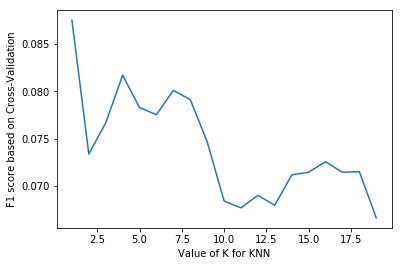

In [40]:
# Plot the results.
plt.plot(range(1,20),means)
plt.xlabel('Value of K for KNN')
plt.ylabel('F1 score based on Cross-Validation')
plt.show()

In [41]:
# Identify the best model.
print(grid.best_score_)
print(grid.best_params_)
print(grid.best_estimator_)

0.08749093731011003
{'n_neighbors': 1}
KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
           metric_params=None, n_jobs=None, n_neighbors=1, p=2,
           weights='uniform')


In [42]:
# Train model using all data and the best known parameters.
# Using best n_neighbors from grid search. Not finished.
knn = KNeighborsClassifier(n_neighbors=1, weights='uniform')
knn.fit(X_train, y_train)
y_pred =  knn.predict(X_test)

knn_confusion = (metrics.confusion_matrix(y_test, y_pred))
knn_precision = (metrics.precision_score(y_test, y_pred, average= 'weighted'))
knn_recall = (metrics.recall_score(y_test, y_pred, average= 'weighted'))
knn_f1 = (metrics.f1_score(y_test, y_pred, average= 'weighted'))

#confusion matrix
print("k-NN confusion matrix:")
print(knn_confusion)
print("")
#precision
print("k-NN precision:")
print(knn_precision)
print("")
#recall
print("k-NN recall:")
print(knn_recall)
print("")
#f-measure
print("k-NN F-measure:")
print(knn_f1)


k-NN confusion matrix:
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 2 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 1]
 [0 0 0 ... 0 0 0]]

k-NN precision:
0.16386444809018127

k-NN recall:
0.1037344398340249

k-NN F-measure:
0.10992986400897722


C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


# Recursive Feature Elimination

In [43]:
%%time

sc = StandardScaler()  
x_norm = sc.fit_transform(X) 

# create a base classifier used to evaluate a subset of attributes

# Recursively remove attributes and build a model on those attributes that remain, 
# using model accuracy to find attributes (combination of attributes)
model = LogisticRegression()

# create the RFE model and list order of importance
rfe = RFE(model, 12)
rfe = rfe.fit(x_norm, y)

# summarize the selection of the attributes
print(rfe.support_)
print(rfe.ranking_)

#Takes genre and compares it with all the features in x. song_hotness, familiarity, longitude, loudness, genre_freq 
#are the winners. CONGRATS FELLOW FEATURES!

C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\preprocessing\data.py:625: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\base.py:462: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
  return self.fit(X, **fit_params).transform(X)


[ True  True False ... False False  True]
[  1   1   7 ... 880  74   1]
Wall time: 11h 51min 28s


In [61]:
rfe_rank = pd.DataFrame(rfe.ranking_, columns = ["rank"])
#final_merge_df = final_merge_df.append(rfe_rank, ignore_index=True)
rfe_rank["column"] = final_merge_df.drop(columns=['ground_truths']).columns.values
rfe_rank_top = rfe_rank[rfe_rank["rank"] == 1]

rfe_rank_top
#.drop(columns=['ground_truths'])
#final_merge_df
#final_merge_df["rfe_rank"] = rfe.ranking_

#final_merge_df.pivot()

,rank,column
0,1,artist_hotness_norm
1,1,artist_mbtags_count_norm
5,1,beats_start_norm
6,1,familiarity_norm
9,1,loudness_norm
11,1,mode_confidence_norm
13,1,start_of_fade_out_norm
15,1,tatums_start_norm
17,1,genre_freq_norm
19,1,time_signature_confidence_norm


In [63]:
rfe_df_top = final_merge_df[['artist_hotness_norm', 'artist_mbtags_count_norm', 'beats_start_norm',
                            'familiarity_norm', 'loudness_norm', 'mode_confidence_norm', 'start_of_fade_out_norm',
                            'tatums_start_norm', 'genre_freq_norm', 'time_signature_confidence_norm', 'song_hotness',
                            'genre_count', 'ground_truths']]

rfe_df_top

,artist_hotness_norm,artist_mbtags_count_norm,beats_start_norm,familiarity_norm,loudness_norm,mode_confidence_norm,start_of_fade_out_norm,tatums_start_norm,genre_freq_norm,time_signature_confidence_norm,song_hotness,genre_count,ground_truths
0,-0.256614,0.686118,-0.256326,-0.304531,0.250577,1.840173,2.227410,-0.474824,0.670865,0.622980,0.405116,44,18
1,-0.647301,-0.455578,-0.609895,-0.396094,-1.352327,-0.956939,-0.720277,-0.386316,0.670865,0.750215,0.374797,44,18
2,-0.267189,0.686118,-0.615952,0.079569,-0.610784,0.452132,-0.123986,-0.392573,0.087432,1.269759,0.425125,44,18
3,-0.884327,-0.455578,-0.266966,-0.612173,0.087140,-0.825496,0.381650,-0.363917,-0.494342,0.114038,0.511424,44,18
4,-0.231600,-0.455578,-0.220773,-0.360267,-0.119366,-1.225083,2.327116,-0.334680,-0.762139,-0.856130,0.301682,44,18
5,0.575019,-0.455578,-0.405370,0.081040,-1.032261,2.092543,0.225621,-0.175038,-0.420438,1.269759,0.392009,44,18
6,0.016977,-0.455578,-0.702755,-0.512130,-1.189257,-1.067351,-0.686410,-0.482242,0.523372,-0.015848,0.304170,44,18
7,1.256511,0.686118,0.241598,0.469823,-0.415137,2.434296,-0.544403,0.168838,0.670865,-1.137108,0.345802,44,18
8,0.608648,0.686118,-0.300360,1.523701,-0.371885,1.919038,0.292175,-0.066561,0.670865,-0.394903,0.485122,44,18
9,-0.987564,-0.455578,0.255398,-1.607781,-0.878762,0.567802,-0.761917,-0.045051,0.122091,1.041796,0.000000,44,18


In [65]:
X2 = rfe_df_top.drop(columns = ['ground_truths'])
y2 = rfe_df_top['ground_truths'].values

# Random state 42 = no RNG keep score unchanged.
X_train2, X_test2, y_train2, y_test2 = train_test_split(X2, y2, test_size=0.20, random_state=42)

print(X_train2.shape, y_train2.shape)
print(X_test2.shape, y_test2.shape)

print("Training_size = {} ; Test_size = {}" .format(len(X_train),len(y_test)))



(1284, 12) (1284,)
(321, 12) (321,)
Training_size = 1123 ; Test_size = 482


# Parameter Tuning 

In [66]:
# Using the test set, compute the confusion matrix, the precision, recall and F-measure scores.
dtree_tune = tree.DecisionTreeClassifier(random_state=0, criterion = 'entropy')
dtree_tune = dtree_tune.fit(X_train2, y_train2)

y_pred2 = dtree_tune.predict(X_test2)

dtree_tune_confusion = (metrics.confusion_matrix(y_test2,y_pred2))
dtree_tune_precision = (metrics.precision_score(y_test2,y_pred2, average='weighted'))   # Parameter "average" is requred if not a binary model
dtree_tune_recall = (metrics.recall_score(y_test2,y_pred2, average='weighted'))      # Parameter "average" is requred if not a binary model
dtree_tune_f1 = (metrics.f1_score(y_test2,y_pred2, average='weighted'))          # Parameter "average" is requred if not a binary model

#confusion matrix
print("Decision tree confusion matrix:")
print(dtree_tune_confusion)
print("")
#precision
print("Decision tree precision:")
print(dtree_tune_precision)
print("")
#recall
print("Decision tree recall:")
print(dtree_tune_recall)
print("")
#f-measure
print("Decision tree F-measure:")
print(dtree_tune_f1)

Decision tree confusion matrix:
[[3 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 3 ... 0 0 0]
 ...
 [0 0 0 ... 1 0 0]
 [0 0 0 ... 0 2 0]
 [0 0 0 ... 0 0 2]]

Decision tree precision:
0.8833778371161549

Decision tree recall:
0.8504672897196262

Decision tree F-measure:
0.8488260009288044


C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


In [67]:
from sklearn import svm

svm_clf_tune = svm.SVC(C=2, gamma=50, kernel='linear', degree = 3)
svm_clf_tune.fit(X_train2,y_train2)

y_pred2 = svm_clf_tune.predict(X_test2)

svm_tune_confusion = (metrics.confusion_matrix(y_test2,y_pred2))
svm_tune_precision = (metrics.precision_score(y_test2,y_pred2, average='weighted'))   # Parameter "average" is requred if not a binary model
svm_tune_recall = (metrics.recall_score(y_test2,y_pred2, average='weighted'))      # Parameter "average" is requred if not a binary model
svm_tune_f1 = (metrics.f1_score(y_test2,y_pred2, average='weighted'))          # Parameter "average" is requred if not a binary model

#confusion matrix
print("SVM confusion matrix:")
print(svm_tune_confusion)
print("")
#precision
print("SVM precision:")
print(svm_tune_precision)
print("")
#recall
print("SVM recall:")
print(svm_tune_recall)
print("")
#f-measure
print("SVM F-measure:")
print(svm_tune_f1)

SVM confusion matrix:
[[3 0 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 1 ... 0 0 0]
 ...
 [0 0 1 ... 1 0 0]
 [0 0 0 ... 0 1 0]
 [0 0 0 ... 0 0 2]]

SVM precision:
0.8408581812787421

SVM recall:
0.7975077881619937

SVM F-measure:
0.7932026609596704


C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


In [68]:
import sklearn.linear_model as linear_model

# Set a few optional parameter.
#lr = LogisticRegression(solver='lbfgs', # Optimized waiting descent.
#                        max_iter=200, 
#                        multi_class='auto') 

# Set a few optional parameter.
lr_clf_tune = linear_model.LogisticRegression(random_state=0, solver='lbfgs', multi_class='multinomial')
# lbfgs = Optimized waiting descent.

# Print out the model.
lr_clf_tune.fit(X_train2, y_train2)

# Logistic regression.
y_pred2 = lr_clf_tune.predict(X_test2)

lr_tune_confusion = (metrics.confusion_matrix(y_test2,y_pred2))
lr_tune_precision = (metrics.precision_score(y_test2,y_pred2, average='weighted'))   # Parameter "average" is requred if not a binary model
lr_tune_recall = (metrics.recall_score(y_test2,y_pred2, average='weighted'))      # Parameter "average" is requred if not a binary model
lr_tune_f1 = (metrics.f1_score(y_test2,y_pred2, average='weighted'))          # Parameter "average" is requred if not a binary model

#confusion matrix
print("Logistic regression confusion matrix:")
print(lr_tune_confusion)
print("")
#precision
print("Logistic regression precision:")
print(lr_tune_precision)
print("")
#recall
print("Logistic regression recall:")
print(lr_tune_recall)
print("")
#f-measure
print("Logistic regression F-measure:")
print(lr_tune_f1)

Logistic regression confusion matrix:
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 2 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]

Logistic regression precision:
0.21367227987985485

Logistic regression recall:
0.2616822429906542

Logistic regression F-measure:
0.21980851556432063


C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:758: ConvergenceWarning: lbfgs failed to converge. Increase the number of iterations.
  "of iterations.", ConvergenceWarning)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning

In [69]:
# Neural Networks

# Multi-layer Perception Model (mlp)
# hidden_layer_sizes: 3 hidden layers, each has 30 neurons.
# 10, 20, 30, or 100... as long as your machine can handle that. Keep as many layer as you want.

mlp_tune = MLPClassifier(hidden_layer_sizes=(30,30,30), 
                    solver='sgd', # sgd optimization algo. Variation of gradient descent.
                    max_iter=2000) # Create neural network with hidden layers. Go up to 1000 iterations. 
mlp.fit(X_train2,y_train2)

# Neural Networks
mlp_pred_class2 = mlp.predict(X_test2)

print(metrics.classification_report(y_test2, y_pred2))

mlpConfusion = metrics.confusion_matrix(y_test2, mlp_pred_class2)
mlpRecall = metrics.recall_score(y_test2, mlp_pred_class2, average='weighted')
mlpPrecision = metrics.precision_score(y_test2, mlp_pred_class2, average='weighted')
mlpF1 = metrics.f1_score(y_test2, mlp_pred_class2, average='weighted')

#confusion matrix
print("Neural Networks confusion matrix:")
print(mlpConfusion)
print("")
#precision
print("Neural Networks precision:")
print(mlpPrecision)
print("")
#recall
print("Neural Networks recall:")
print(mlpRecall)
print("")
#f-measure
print("Neural Networks F-measure:")
print(mlpF1)

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         3
           1       0.00      0.00      0.00         6
           2       0.00      0.00      0.00         3
           3       0.00      0.00      0.00         2
           4       0.00      0.00      0.00         1
           5       0.00      0.00      0.00         2
           6       0.00      0.00      0.00         4
           7       0.00      0.00      0.00         6
           8       0.00      0.00      0.00         4
           9       0.86      0.83      0.84        29
          10       0.00      0.00      0.00         2
          11       0.00      0.00      0.00         0
          12       0.33      0.11      0.17         9
          13       0.50      0.50      0.50         2
          14       0.14      0.25      0.18         4
          15       0.00      0.00      0.00         1
          16       0.43      0.75      0.55         4
          17       1.00    

C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:562: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1143: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)
C:\Users\Jimmy\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)
C:\Users\Jimmy\Anaconda3\lib\site-package

In [75]:
#rfe_df_top_gt = rfe_df_top[rfe.df.tgroupby()

top_gt = rfe_df_top.sort_values(by='ground_truths', axis=0, ascending=False)

#top_gt.sort_values(by='gt', axis=0, ascending=False, inplace=True)
top_gt

,artist_hotness_norm,artist_mbtags_count_norm,beats_start_norm,familiarity_norm,loudness_norm,mode_confidence_norm,start_of_fade_out_norm,tatums_start_norm,genre_freq_norm,time_signature_confidence_norm,song_hotness,genre_count,ground_truths
1483,-0.902152,-0.455578,-0.329364,-0.781066,0.688068,0.042030,0.404060,-0.096524,0.670865,-1.216630,0.460485,12,68
1494,-1.164296,-0.455578,-0.183042,-1.646136,-0.796307,-1.167248,-0.690094,-0.256020,0.670865,0.609726,0.000000,12,68
1493,-1.164296,-0.455578,-0.205287,-1.646136,-0.012984,-2.518484,-0.378187,0.031650,0.670865,-1.118553,0.241768,12,68
1492,-0.902152,-0.455578,-0.172789,-0.781066,0.560152,0.967390,1.194847,-0.360797,0.670865,-0.217303,0.319566,12,68
1491,-0.902152,-0.455578,-0.277641,-0.781066,0.749725,-2.518484,-0.381924,-0.360833,0.670865,0.363208,0.304170,12,68
1490,-1.356372,-0.455578,-0.051819,-1.517392,-0.188938,0.972647,-0.371128,-0.331887,0.670865,-1.380976,0.000000,12,68
1484,-1.219405,-0.455578,-0.618270,-1.322593,-0.703177,-2.371268,0.272690,-0.394967,0.670865,-1.380976,0.000000,12,68
1485,-0.902152,-0.455578,-0.552184,-0.781066,0.710154,-1.435392,-0.113146,-0.326700,0.670865,0.315494,0.304170,12,68
1486,-0.902152,-0.455578,-0.287051,-0.781066,-0.502377,2.297595,0.094048,-0.373003,0.670865,-1.380976,0.000000,12,68
1487,-1.164296,-0.455578,-0.474633,-1.646136,-0.326608,0.651926,-0.295983,-0.246589,0.670865,1.171682,0.000000,12,68
